In [1]:
%load_ext autoreload
%autoreload 2
import IPython.display as ipd
ipd.Audio("./samples/bass_riff.wav")

In [2]:
from effects import SignalChain, Gain, Effect
import numpy as np
import librosa

def process_samples(effect: Effect, samples: np.ndarray) -> np.ndarray:
    samples_out = np.zeros(samples.shape)
    for i, sample in enumerate(samples):
        samples_out[i] = effect.process(sample)
    return samples_out

samples, sr = librosa.load("./samples/bass_riff.wav")
samples = samples[:700_000]

In [22]:
chain = Gain(4)
gain_signal = process_samples(chain, samples)
ipd.Audio(gain_signal, rate=sr)

In [39]:
from effects import FeedForwardComb, SignalChain

samples, sr = librosa.load("./samples/epiano.wav")

# Echo effect
chain = SignalChain([Gain(4), FeedForwardComb(delay_samples=15_000, b0=1, bM=0.5)])
gain_ffc_signal = process_samples(chain, samples)

ipd.Audio(gain_ffc_signal, rate=sr)

In [42]:
from effects import FeedBackComb, SignalChain

# Delay effect
chain = SignalChain([Gain(4), FeedBackComb(delay_samples=15_000, b0=1, feedback=0.7)])
gain_ffc_signal = process_samples(chain, samples)

ipd.Audio(gain_ffc_signal, rate=sr)

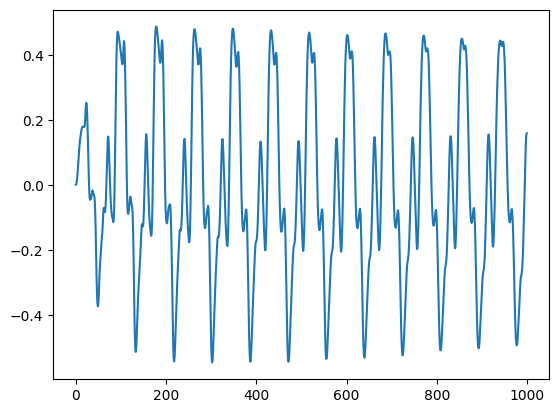

In [45]:
import matplotlib.pyplot as plt

plt.plot(samples[:1000])


In [ ]:
from effects import OneZeroFilter

high_pass = OneZeroFilter(b1=-1)
